In [18]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
import numpy as np
import torchvision.transforms as transforms
from sklearn.model_selection import train_test_split
from torch.utils.tensorboard import SummaryWriter
import torchvision
from PIL import Image
torch.set_default_tensor_type(torch.cuda.FloatTensor)
torch.cuda.is_available()
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device


device(type='cuda')

In [19]:
# Mounting google drive
from google.colab import drive
drive.mount('/content/drive/')


Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [20]:
from os import listdir
from numpy import asarray
from numpy import save
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
import numpy as np

# define location of dataset
folder = r"/content/drive/MyDrive/dataset1"
classws = ['monkeys/', 'koalas/']  # two classes: monkeys and jaguars
train_imgs, train_labels = list(), list()
test_imgs, test_labels = list(), list()

# Loop over class directories (train set)
for e in classws:
    for file in listdir(folder+'/train'+f"/{e}"):
        # Determine class based on folder name
        output = 0.0
        if 'monkeys' in e:
            output = 1.0  # Label monkeys as 1.0
        # Load image
        photo = load_img(folder+'/train'+f"/{e}"+file, target_size=(224, 224))
        # Convert to numpy array
        photo = img_to_array(photo)
        # Store
        train_imgs.append(photo)
        train_labels.append(output)

# Convert to numpy arrays
train_imgs = asarray(train_imgs)
train_labels = asarray(train_labels)

# Save the reshaped photos
save('train_imgs.npy', train_imgs)
save('train_labels.npy', train_labels)

# Loop over class directories (test set)
for e in classws:
    for file in listdir(folder+'/test'+f"/{e}"):
        # Determine class based on folder name
        output = 0.0
        if 'monkeys' in e:
            output = 1.0  # Label monkeys as 1.0
        # Load image
        photo = load_img(folder+'/test'+f"/{e}"+file, target_size=(224, 224))
        # Convert to numpy array
        photo = img_to_array(photo)
        # Store
        test_imgs.append(photo)
        test_labels.append(output)

# Convert to numpy arrays
test_imgs = asarray(test_imgs)
test_labels = asarray(test_labels)

# Save the final numpy arrays
save('test_imgs.npy', test_imgs)
save('test_labels.npy', test_labels)

# Save the reshaped photos
train_imgs = np.transpose(train_imgs, (0, 3, 1, 2))  # Change to (N, C, H, W)
test_imgs = np.transpose(test_imgs, (0, 3, 1, 2))    # Change to (N, C, H, W)

# Print the shapes
print(train_imgs.shape, train_labels.shape)
print(test_imgs.shape, test_labels.shape)

test_labels

(160, 3, 224, 224) (160,)
(40, 3, 224, 224) (40,)


array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0.])

In [21]:
class VGGBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(VGGBlock, self).__init__()
        self.block = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )

    def forward(self, x):
        return self.block(x)

class VGGNet1Block(nn.Module):
    def __init__(self, num_classes=2):
        super(VGGNet1Block, self).__init__()
        self.features = VGGBlock(3, 64)
        self.fc = nn.Sequential(
            nn.Linear(64 * 112 * 112, 128),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(128, num_classes)
        )

    def forward(self, x):
        x = self.features(x)
        x = x.view(x.size(0), -1)
        x = self.fc(x)
        return x

class VGGNet3Block(nn.Module):
    def __init__(self, num_classes=2):
        super(VGGNet3Block, self).__init__()

        self.block1 = VGGBlock(3, 64)
        self.block2 = VGGBlock(64, 128)
        self.block3 = VGGBlock(128, 256)

        self.fc1 = nn.Sequential(
            nn.Linear(256 * 28 * 28, 512),
            nn.ReLU(),
            nn.Dropout(0.5),
        )
        self.fc2 = nn.Sequential(
            nn.Linear(512,256),
            nn.ReLU(),
            nn.Dropout(0.5),
        )
        self.fc3 = nn.Linear(256, num_classes)

    def forward(self, x):
        x = self.block1(x)
        x = self.block2(x)
        x = self.block3(x)

        x = x.view(x.size(0), -1)

        x = self.fc1(x)
        x = self.fc2(x)
        x = self.fc3(x)

        return x

class VGGNet3Block_AUG(nn.Module):
    def __init__(self, num_classes=2):
        super(VGGNet3Block_AUG, self).__init__()

        self.block1 = VGGBlock(3, 64)
        self.block2 = VGGBlock(64, 128)
        self.block3 = VGGBlock(128, 256)

        self.fc1 = nn.Sequential(
            nn.Linear(256 * 28 * 28, 512),
            nn.ReLU(),
            nn.Dropout(0.5),
        )
        self.fc2 = nn.Sequential(
            nn.Linear(512,256),
            nn.ReLU(),
            nn.Dropout(0.5),
        )
        self.fc3 = nn.Linear(256, num_classes)

    def forward(self, x):
        x = self.block1(x)
        x = self.block2(x)
        x = self.block3(x)

        x = x.view(x.size(0), -1)

        x = self.fc1(x)
        x = self.fc2(x)
        x = self.fc3(x)

        return x

class MLP_VGG16_Comparable(nn.Module):
    def __init__(self, num_classes =2):
        super(MLP_VGG16_Comparable, self).__init__()
        # First hidden layer with 800 neurons
        self.fc1 = nn.Linear(224*224*3, 864)
        # Second hidden layer with 4096 neurons
        self.fc2 = nn.Linear(864, 4096)
        # Third hidden layer with 4096 neurons
        self.fc3 = nn.Linear(4096, 4096)
        # Output layer with 2 neurons (for binary classification)
        self.fc4 = nn.Linear(4096, 2)

        self.relu = nn.ReLU()  # ReLU activation function

    def forward(self, x):
        x = x.view(x.size(0), -1)
        x = self.relu(self.fc1(x))
        x = self.relu(self.fc2(x))
        x = self.relu(self.fc3(x))
        x = self.fc4(x)
        return x



In [22]:
X_train = torch.tensor(train_imgs, dtype=torch.float32)
X_test = torch.tensor(test_imgs, dtype=torch.float32)
y_train = torch.tensor(train_labels, dtype=torch.long)
y_test = torch.tensor(test_labels, dtype=torch.long)

transform_train = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(5),
    transforms.RandomAffine(degrees=0, translate=(0.1, 0.1)),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
    transforms.ToTensor(),
])

# For testing, we don't apply augmentation
transform_test = transforms.Compose([
    transforms.ToTensor(),
])

def preprocess_image_for_pil(image_array):
    # Ensure the image array is in the correct format (H, W, C)
    image_array = np.transpose(image_array, (1, 2, 0))  # (C, H, W) -> (H, W, C)
    image_array = np.clip(image_array, 0, 255).astype(np.uint8)  # Clip values to the range [0, 255] and convert to uint8
    return Image.fromarray(image_array)

train_images_tensor = torch.stack([transform_test(preprocess_image_for_pil(X_train[i].cpu().numpy())) for i in range(len(X_train))])
test_images_tensor = torch.stack([transform_test(preprocess_image_for_pil(X_test[i].cpu().numpy())) for i in range(len(X_test))])

train_dataset = TensorDataset(train_images_tensor, y_train)
test_dataset = TensorDataset(test_images_tensor, y_test)

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True, generator=torch.Generator(device='cuda'))
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False, generator=torch.Generator(device='cuda'))

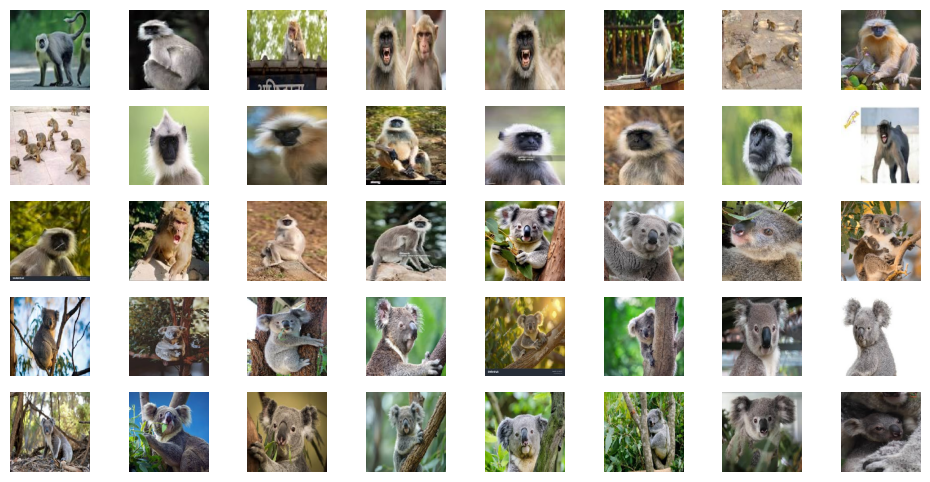

In [23]:
import matplotlib.pyplot as plt
# Plot the batch of images
fig, axes = plt.subplots(5, 8, figsize=(12, 6))  # Grid: 2 rows, 4 columns
for i, ax in enumerate(axes.flat):
    img_array = test_images_tensor[i].permute(1, 2, 0).detach().cpu().numpy()  # (H, W, C)
    img_array = img_array.clip(0, 1)  # Clip to [0, 1]
    ax.imshow(img_array)
    ax.axis("off")  # Turn off axes
plt.show()

In [35]:
import time
import pandas as pd
def train_and_evaluate(model, train_loader, test_loader, epochs=10, device='cuda', aug=False):
    model.to(device)
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=1e-5)

    consecutive_100_accuracy = 0

    training_times = []
    training_losses = []
    training_accuracies = []
    testing_accuracies = []
    num_parameters = sum(p.numel() for p in model.parameters() if p.requires_grad)

    iteration = 0

    if aug:
        aug_str = "Augmented"
    else:
        aug_str = ""

    writer = SummaryWriter(f'runs/{model.__class__.__name__} {aug_str}')

    # Start the training loop
    for epoch in range(epochs):
        start_time = time.time()

        # Training phase
        model.train()
        running_loss = 0.0
        correct_train = 0
        total_train = 0

        for inputs, labels in train_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()

            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()

            _, predicted = outputs.max(1)
            total_train += labels.size(0)
            correct_train += (predicted == labels).sum().item()
            accuracy = correct_train / total_train
            writer.add_scalar(f'Training Loss', loss.item(), iteration)
            writer.add_scalar(f'Training Accuracy', accuracy, iteration)

            iteration += 1

        avg_train_loss = running_loss / len(train_loader)
        train_accuracy = 100 * correct_train / total_train
        training_losses.append(avg_train_loss)
        training_accuracies.append(train_accuracy)

        # Testing phase
        model.eval()
        correct_test = 0
        total_test = 0
        inputs_test = []
        pred_test = []
        with torch.no_grad():
            for inputs, labels in test_loader:
                inputs, labels = inputs.to(device), labels.to(device)
                inputs_test.append(inputs)
                outputs = model(inputs)
                _, predicted = outputs.max(1)
                pred_test.extend(predicted.tolist())
                total_test += labels.size(0)
                correct_test += (predicted == labels).sum().item()
                test_accuracy = correct_test / total_test
                writer.add_scalar(f'testing Accuracy', test_accuracy, iteration)
        inputs_test = torch.cat(inputs_test, dim=0)
        img_grid = torchvision.utils.make_grid(inputs_test)
        writer.add_image("Test Images", img_grid, iteration)
        writer.add_text(
            f'predictions',
            " ".join(map(str, pred_test)),
            iteration)

        test_accuracy = 100 * correct_test / total_test
        testing_accuracies.append(test_accuracy)

        # Calculate time taken for this epoch
        epoch_time = time.time() - start_time
        training_times.append(epoch_time)

        # Early stopping check: if train accuracy is 100% for 5 consecutive epochs
        if train_accuracy == 100.0:
            consecutive_100_accuracy += 1
        else:
            consecutive_100_accuracy = 0

        # Stop if we reached 5 consecutive epochs with 100% training accuracy
        if consecutive_100_accuracy >= 5:
            print(f"Epoch {epoch+1}/{epochs} - Loss: {avg_train_loss:.4f} - Train Accuracy: {train_accuracy:.2f}% - Test Accuracy: {test_accuracy:.2f}% - Time: {epoch_time:.2f}s")
            print(f"Training stopped early after {epoch+1} epochs due to 100% accuracy for {5} consecutive epochs.")
            break


    print(f"Epoch {epoch+1}/{epochs} - Loss: {avg_train_loss:.4f} - Train Accuracy: {train_accuracy:.2f}% - Test Accuracy: {test_accuracy:.2f}% - Time: {epoch_time:.2f}s")
    training_time = np.sum(training_times)
    training_loss = training_losses[-1]
    training_accuracy = training_accuracies[-1]
    testing_accuracy = testing_accuracies[-1]
    writer.close()

    return  model, epoch ,training_time, training_loss, training_accuracy, testing_accuracy, num_parameters




In [25]:
X_train = torch.tensor(train_imgs, dtype=torch.float32).to("cpu")
X_test = torch.tensor(test_imgs, dtype=torch.float32).to("cpu")
y_train = torch.tensor(train_labels, dtype=torch.long).to("cpu")
y_test = torch.tensor(test_labels, dtype=torch.long).to("cpu")

models = []
results = []
aug = False

for i in range(3):
    training_times = []
    training_losses = []
    training_accuracies = []
    testing_accuracies = []
    if i == 0:
        model = VGGNet1Block(num_classes=2).to(device)
    elif i == 1:
        model = VGGNet3Block(num_classes=2).to(device)
    elif i == 2:
        model = VGGNet3Block_AUG(num_classes=2).to(device)
        train_images_tensor = torch.stack([transform_train(preprocess_image_for_pil(X_train[i].cpu().numpy())) for i in range(len(X_train))])
        train_images_tensor = torch.cat((train_images_tensor,X_train), dim = 0)
        test_images_tensor = torch.stack([transform_test(preprocess_image_for_pil(X_test[i].cpu().numpy())) for i in range(len(X_test))])
        y_train = torch.cat((y_train,y_train),dim=0)

        # Create TensorDataset with augmented images and labels
        train_dataset_aug = TensorDataset(train_images_tensor, y_train)
        test_dataset_aug = TensorDataset(test_images_tensor, y_test)
        train_loader = DataLoader(train_dataset_aug, batch_size=8, shuffle=True, generator=torch.Generator(device='cuda'))
        test_loader = DataLoader(test_dataset_aug, batch_size=8, shuffle=False, generator=torch.Generator(device='cuda'))
        aug = True
    for j in range(1):
        model,epoch,training_time,training_loss,training_accuracy,testing_accuracy,models_params = train_and_evaluate(model, train_loader, test_loader, epochs=100, device=device, aug=aug)
        training_times.append(training_time)
        training_losses.append(training_loss)
        training_accuracies.append(training_accuracy)
        testing_accuracies.append(testing_accuracy)

    torch.cuda.empty_cache()  # Frees up unused cached memory

    models.append(model)

    results.append({
        'Model': model.__class__.__name__,
        'Training Time (s)': np.mean(training_times),  # Store total training time
        'Training Loss': np.mean(training_losses),
        'Training Accuracy (%)': np.mean(training_accuracies),
        'Testing Accuracy (%)': np.mean(testing_accuracies),
        'Number of Parameters': models_params
    })


Epoch 45/100 - Loss: 0.0591 - Train Accuracy: 100.00% - Test Accuracy: 77.50% - Time: 2.73s
Training stopped early after 45 epochs due to 100% accuracy for 5 consecutive epochs.
Epoch 45/100 - Loss: 0.0591 - Train Accuracy: 100.00% - Test Accuracy: 77.50% - Time: 2.73s
Epoch 100/100 - Loss: 0.0441 - Train Accuracy: 98.12% - Test Accuracy: 92.50% - Time: 3.48s
Epoch 100/100 - Loss: 0.0911 - Train Accuracy: 97.50% - Test Accuracy: 82.50% - Time: 5.73s


In [36]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
import numpy as np
from torchvision import models as Models
from torchvision.models import VGG16_Weights
from torch.utils.tensorboard import SummaryWriter
import pandas as pd
import time  # Import time module

# Load and process data
X_train = torch.tensor(train_imgs, dtype=torch.float32)
X_test = torch.tensor(test_imgs, dtype=torch.float32)
y_train = torch.tensor(train_labels, dtype=torch.long)
y_test = torch.tensor(test_labels, dtype=torch.long)

train_images_tensor = torch.stack([transform_test(preprocess_image_for_pil(X_train[i].cpu().numpy())) for i in range(len(X_train))])
test_images_tensor = torch.stack([transform_test(preprocess_image_for_pil(X_test[i].cpu().numpy())) for i in range(len(X_test))])

train_dataset = TensorDataset(train_images_tensor, y_train)
test_dataset = TensorDataset(test_images_tensor, y_test)

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True, generator=torch.Generator(device='cuda'))
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False, generator=torch.Generator(device='cuda'))

# Load pretrained VGG16 model
model = Models.vgg16(weights=VGG16_Weights.IMAGENET1K_V1)
model.classifier[6] = nn.Linear(4096, 2)  # Adjust output for binary classification

# Set all layers to be trainable
for param in model.parameters():
    param.requires_grad = True

# Transfer model to GPU if available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

# Initialize results list to track training and testing performance
training_times = []
training_losses = []
training_accuracies = []
testing_accuracies = []
# Training loop
num_epochs = 10

for i in range(5):
    model,epoch,training_time,training_loss,training_accuracy,testing_accuracy,models_params = train_and_evaluate(model, train_loader, test_loader, epochs=num_epochs, device=device, aug=False)
    training_times.append(training_time)
    training_losses.append(training_loss)
    training_accuracies.append(training_accuracy)
    testing_accuracies.append(testing_accuracy)

# Store model metrics
models.append(model)

results.append({
    'Model': f'{model.__class__.__name__}16 fully tuned',
    'Training Time (s)': np.mean(training_times),  # Store total training time
    'Training Loss': np.mean(training_losses),
    'Training Accuracy (%)': np.mean(training_accuracies),
    'Testing Accuracy (%)': np.mean(testing_accuracies),
    'Number of Parameters': models_params
})

Epoch 7/10 - Loss: 0.0007 - Train Accuracy: 100.00% - Test Accuracy: 100.00% - Time: 5.02s
Training stopped early after 7 epochs due to 100% accuracy for 5 consecutive epochs.
Epoch 7/10 - Loss: 0.0007 - Train Accuracy: 100.00% - Test Accuracy: 100.00% - Time: 5.02s
Epoch 5/10 - Loss: 0.0000 - Train Accuracy: 100.00% - Test Accuracy: 100.00% - Time: 5.18s
Training stopped early after 5 epochs due to 100% accuracy for 5 consecutive epochs.
Epoch 5/10 - Loss: 0.0000 - Train Accuracy: 100.00% - Test Accuracy: 100.00% - Time: 5.18s
Epoch 5/10 - Loss: 0.0000 - Train Accuracy: 100.00% - Test Accuracy: 100.00% - Time: 4.90s
Training stopped early after 5 epochs due to 100% accuracy for 5 consecutive epochs.
Epoch 5/10 - Loss: 0.0000 - Train Accuracy: 100.00% - Test Accuracy: 100.00% - Time: 4.90s
Epoch 5/10 - Loss: 0.0000 - Train Accuracy: 100.00% - Test Accuracy: 100.00% - Time: 4.93s
Training stopped early after 5 epochs due to 100% accuracy for 5 consecutive epochs.
Epoch 5/10 - Loss: 0.00

In [28]:
# Load the VGG16 model
model = Models.vgg16(weights=VGG16_Weights.IMAGENET1K_V1)

# Freeze all convolutional layers
for param in model.features.parameters():
    param.requires_grad = False

# Modify the classifier for binary classification
model.classifier[6] = nn.Linear(4096, 2)
nn.init.kaiming_normal_(model.classifier[6].weight)  # Initialize weights
nn.init.constant_(model.classifier[6].bias, 0)  # Initialize bias

# Transfer model to GPU if available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

# Define loss, optimizer, and scheduler
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.classifier.parameters(), lr=0.001, momentum=0.9)
scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.1)

# Initialize results list to track training and testing performance
training_times = []
training_losses = []
training_accuracies = []
testing_accuracies = []
# Training loop
num_epochs = 10

for i in range(5):
    model,epoch,training_time,training_loss,training_accuracy,testing_accuracy,models_params = train_and_evaluate(model, train_loader, test_loader, epochs=num_epochs, device=device, aug=False)
    training_times.append(training_time)
    training_losses.append(training_loss)
    training_accuracies.append(training_accuracy)
    testing_accuracies.append(testing_accuracy)

# Store model metrics
models.append(model)

results.append({
    'Model': f'{model.__class__.__name__}16 FC tuned',
    'Training Time (s)': np.mean(training_times),  # Store total training time
    'Training Loss': np.mean(training_losses),
    'Training Accuracy (%)': np.mean(training_accuracies),
    'Testing Accuracy (%)': np.mean(testing_accuracies),
    'Number of Parameters': models_params
})



Epoch 10/10 - Loss: 0.0093 - Train Accuracy: 100.00% - Test Accuracy: 97.50% - Time: 3.44s
Epoch 5/10 - Loss: 0.0002 - Train Accuracy: 100.00% - Test Accuracy: 97.50% - Time: 3.10s
Training stopped early after 5 epochs due to 100% accuracy for 5 consecutive epochs.
Epoch 5/10 - Loss: 0.0002 - Train Accuracy: 100.00% - Test Accuracy: 97.50% - Time: 3.10s
Epoch 5/10 - Loss: 0.0000 - Train Accuracy: 100.00% - Test Accuracy: 100.00% - Time: 3.11s
Training stopped early after 5 epochs due to 100% accuracy for 5 consecutive epochs.
Epoch 5/10 - Loss: 0.0000 - Train Accuracy: 100.00% - Test Accuracy: 100.00% - Time: 3.11s
Epoch 5/10 - Loss: 0.0000 - Train Accuracy: 100.00% - Test Accuracy: 100.00% - Time: 3.06s
Training stopped early after 5 epochs due to 100% accuracy for 5 consecutive epochs.
Epoch 5/10 - Loss: 0.0000 - Train Accuracy: 100.00% - Test Accuracy: 100.00% - Time: 3.06s
Epoch 5/10 - Loss: 0.0000 - Train Accuracy: 100.00% - Test Accuracy: 100.00% - Time: 3.30s
Training stopped ea

In [29]:
model = MLP_VGG16_Comparable(num_classes = 2)

# Check number of parameters
total_params = sum(p.numel() for p in model.parameters())

# Transfer model to GPU if available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

# Initialize results list to track training and testing performance
training_times = []
training_losses = []
training_accuracies = []
testing_accuracies = []
# Training loop
num_epochs = 10

for i in range(5):
    model,epoch,training_time,training_loss,training_accuracy,testing_accuracy,models_params = train_and_evaluate(model, train_loader, test_loader, epochs=num_epochs, device=device, aug=False)
    training_times.append(training_time)
    training_losses.append(training_loss)
    training_accuracies.append(training_accuracy)
    testing_accuracies.append(testing_accuracy)

# Store model metrics
models.append(model)

results.append({
    'Model': model.__class__.__name__,
    'Training Time (s)': np.mean(training_times),  # Store total training time
    'Training Loss': np.mean(training_losses),
    'Training Accuracy (%)': np.mean(training_accuracies),
    'Testing Accuracy (%)': np.mean(testing_accuracies),
    'Number of Parameters': models_params
})




Epoch 10/10 - Loss: 0.3800 - Train Accuracy: 84.38% - Test Accuracy: 62.50% - Time: 2.09s
Epoch 10/10 - Loss: 0.1292 - Train Accuracy: 95.62% - Test Accuracy: 55.00% - Time: 2.32s
Epoch 7/10 - Loss: 0.0159 - Train Accuracy: 100.00% - Test Accuracy: 65.00% - Time: 2.11s
Training stopped early after 7 epochs due to 100% accuracy for 5 consecutive epochs.
Epoch 7/10 - Loss: 0.0159 - Train Accuracy: 100.00% - Test Accuracy: 65.00% - Time: 2.11s
Epoch 7/10 - Loss: 0.0050 - Train Accuracy: 100.00% - Test Accuracy: 57.50% - Time: 2.10s
Training stopped early after 7 epochs due to 100% accuracy for 5 consecutive epochs.
Epoch 7/10 - Loss: 0.0050 - Train Accuracy: 100.00% - Test Accuracy: 57.50% - Time: 2.10s
Epoch 9/10 - Loss: 0.0034 - Train Accuracy: 100.00% - Test Accuracy: 60.00% - Time: 2.76s
Training stopped early after 9 epochs due to 100% accuracy for 5 consecutive epochs.
Epoch 9/10 - Loss: 0.0034 - Train Accuracy: 100.00% - Test Accuracy: 60.00% - Time: 2.76s


In [30]:
# Convert the updated list to DataFrame (if required)
results_df = pd.DataFrame(results)

# Print the results table
print(results_df)

                  Model  Training Time (s)  Training Loss  \
0          VGGNet1Block         114.186053       0.059080   
1          VGGNet3Block         350.896902       0.044133   
2      VGGNet3Block_AUG         590.237502       0.091091   
3     VGG16 fully tuned          27.658598       0.000154   
4        VGG16 FC tuned          18.794315       0.001901   
5  MLP_VGG16_Comparable          18.952545       0.106719   

   Training Accuracy (%)  Testing Accuracy (%)  Number of Parameters  
0                100.000                  77.5             102799554  
1                 98.125                  92.5             104038210  
2                 97.500                  82.5             104038210  
3                100.000                  98.5             134268738  
4                100.000                  99.0             119554050  
5                 96.000                  60.0             150389602  


In [37]:
%load_ext tensorboard
%tensorboard --logdir=runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 15307), started 0:09:27 ago. (Use '!kill 15307' to kill it.)

<IPython.core.display.Javascript object>

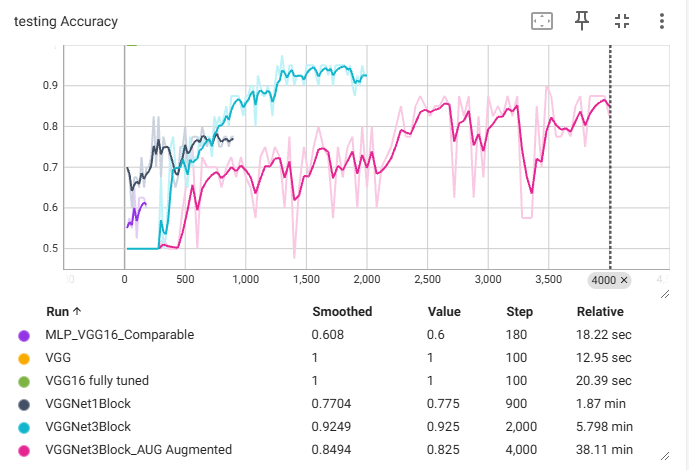

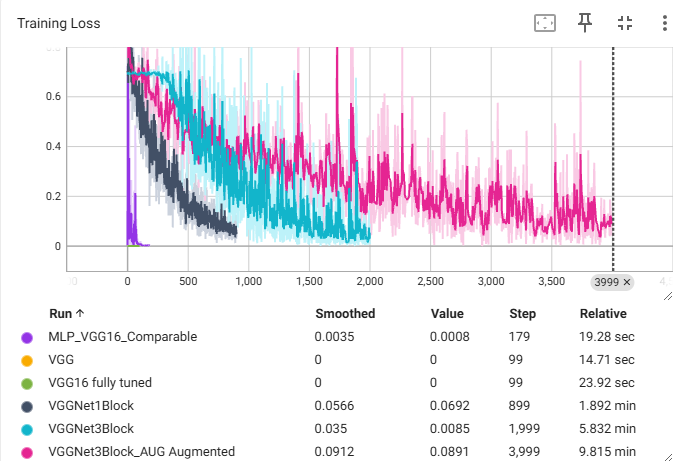

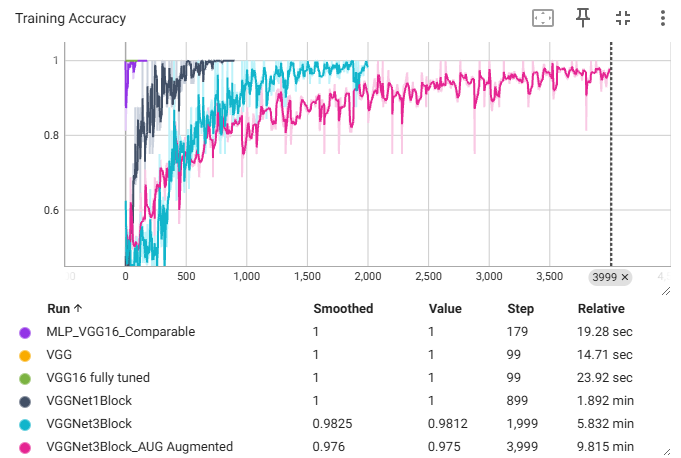

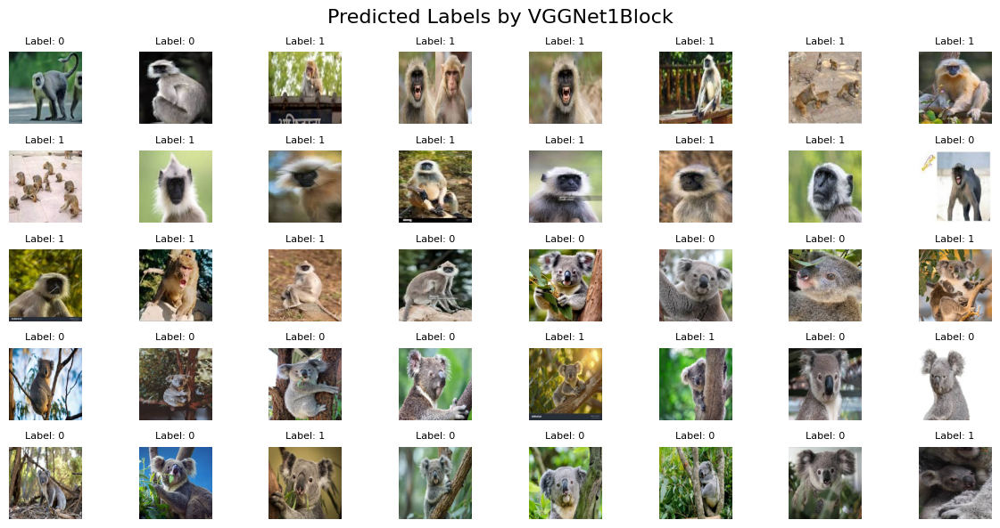

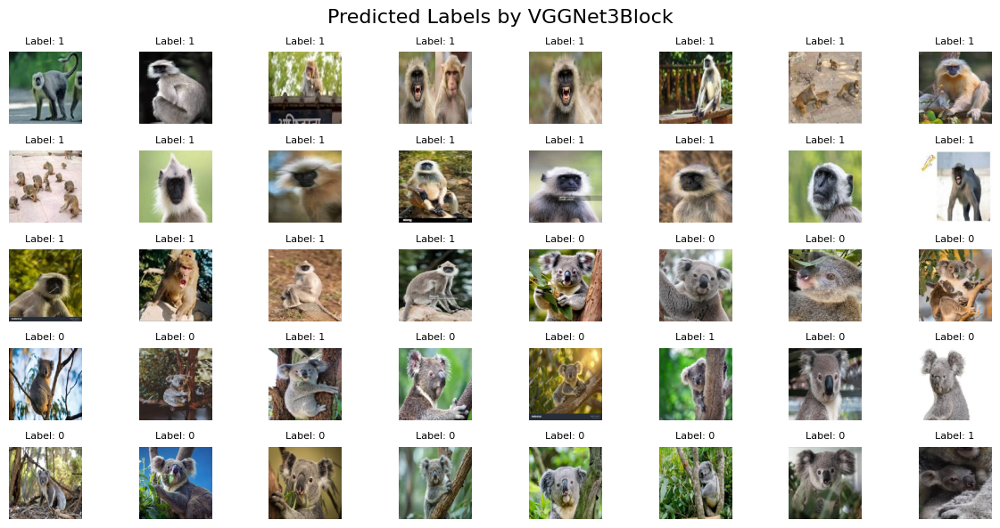

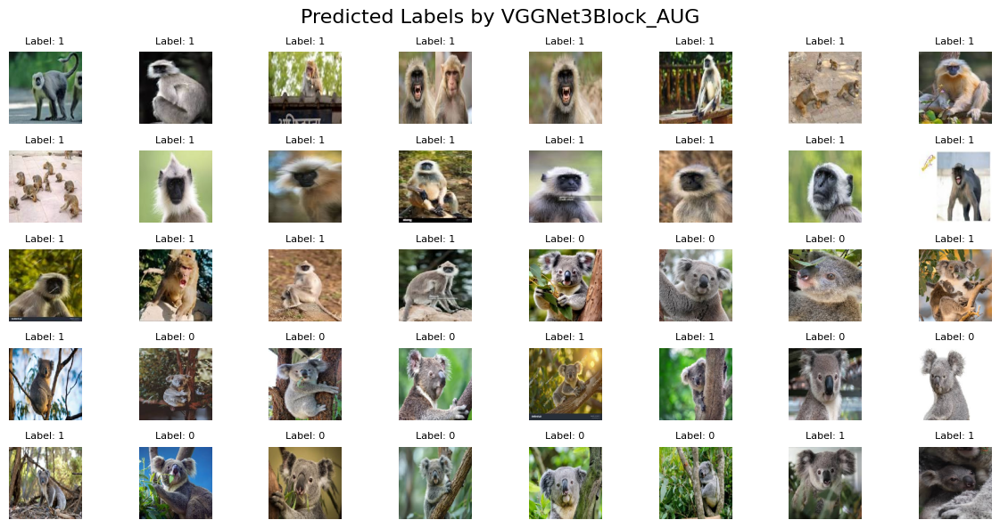

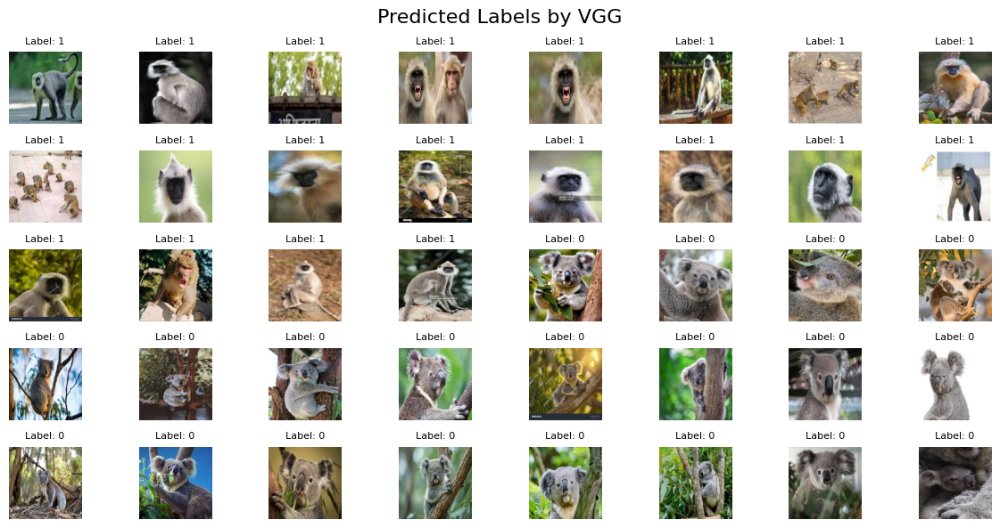

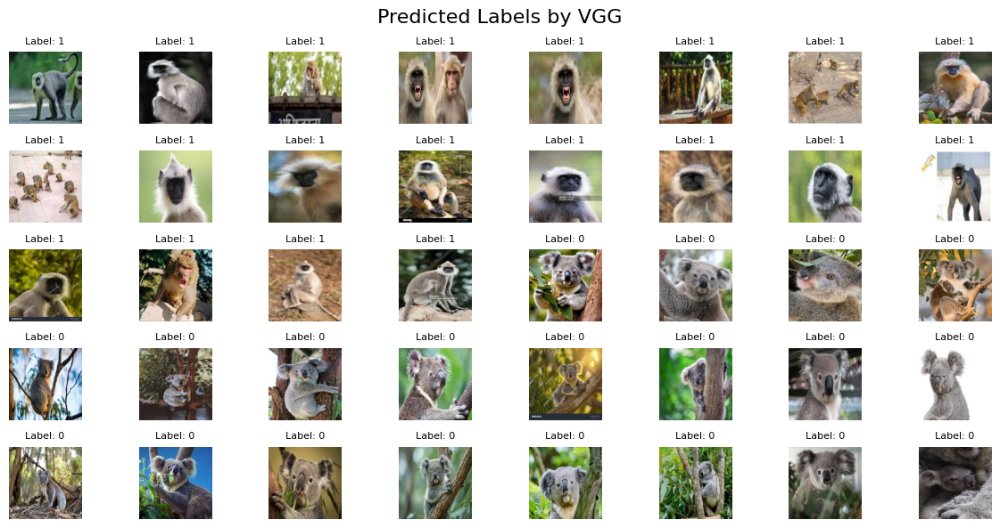

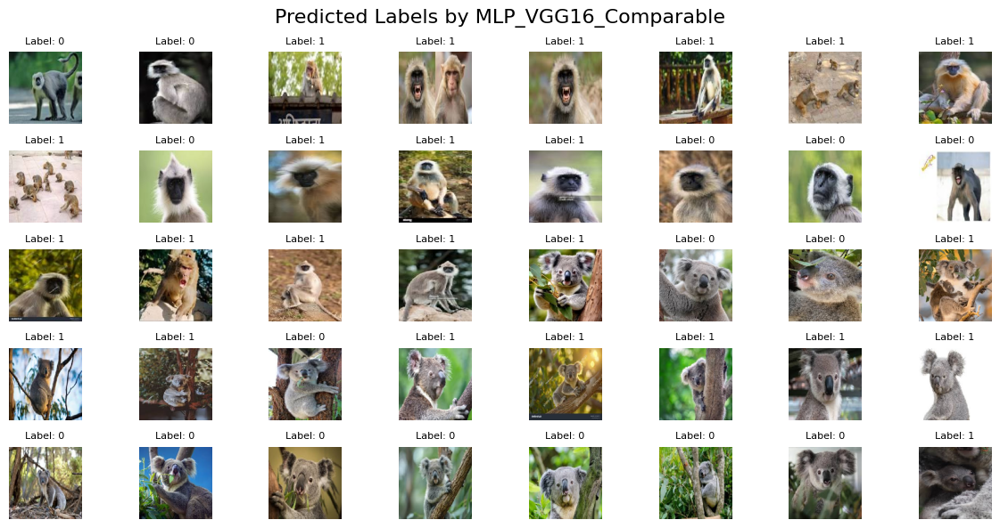

In [32]:
for model in models:
    model.eval()
    preds =[]
    with torch.no_grad():
          test_images_tensor = test_images_tensor.to(device)
          outputs = model(test_images_tensor)
          _, predicted_labels = torch.max(outputs, 1)  # Get the predicted class labels

          # Plot the batch of images with predictions
          fig, axes = plt.subplots(5, 8, figsize=(12, 6))  # Grid: 5 rows, 8 columns
          for i, ax in enumerate(axes.flat):
              img_array = test_images_tensor[i].permute(1, 2, 0).detach().cpu().numpy()  # (H, W, C)
              img_array = img_array.clip(0, 1)  # Clip to [0, 1]

              # Display the image
              ax.imshow(img_array)

              # Add predicted label below the image
              ax.set_title(f"Label: {predicted_labels[i].item()}", fontsize=8)

              ax.axis("off")  # Turn off axes

          plt.tight_layout()
          plt.suptitle(f'Predicted Labels by {model.__class__.__name__}', fontsize=16)
          plt.subplots_adjust(top=0.9)
          plt.show()

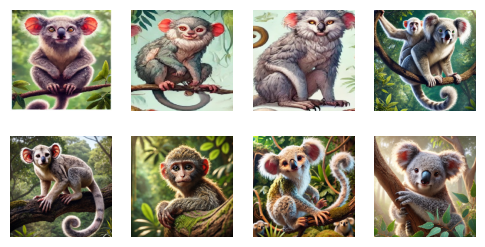

In [33]:

#load images generated with AI
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Path to the folder containing images
folder_path = "/content/drive/MyDrive/dataset1/AI/"

# List all image files in the folder (e.g., .png, .jpg, .jpeg)
image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Dictionary to store resized images as NumPy arrays
image_arrays = []

for image_file in image_files:
    photo = load_img(folder_path+image_file, target_size=(224, 224))
    photo = img_to_array(photo)
    image_arrays.append(photo)


image_arrays = np.array(image_arrays)
Ai_images = np.transpose(image_arrays, (0, 3, 1, 2))

Ai_images.shape
Ai_images = torch.tensor(Ai_images, dtype=torch.float32)
Ai_images = torch.stack([transform_test(preprocess_image_for_pil(Ai_images[i].cpu().numpy())) for i in range(len(Ai_images))])

# Plot the batch of images
fig, axes = plt.subplots(2, 4, figsize=(6, 3))  # Grid: 2 rows, 4 columns
for i, ax in enumerate(axes.flat):
    img_array = Ai_images[i].permute(1, 2, 0).detach().cpu().numpy()  # (H, W, C)
    img_array = img_array.clip(0, 1)  # Clip to [0, 1]
    ax.imshow(img_array)
    ax.axis("off")  # Turn off axes
plt.show()



In [41]:
count = 0
for model in models:
    model.eval()
    preds =[]
    count += 1
    with torch.no_grad():
          inputs = Ai_images
          inputs = inputs.to(device)
          outputs = model(inputs)
          _, predicted = outputs.max(1)
          preds.extend(predicted.tolist())
    if count ==4:
        print(f'{model.__class__.__name__}16 fully tuned ',preds)
    else:
        print(model.__class__.__name__,preds)




VGGNet1Block [0, 1, 0, 0, 0, 0, 0, 0]
VGGNet3Block [0, 0, 0, 0, 0, 0, 0, 0]
VGGNet3Block_AUG [0, 1, 0, 0, 1, 0, 0, 0]
VGG16 fully tuned  [0, 0, 0, 0, 0, 0, 0, 0]
VGG [0, 0, 0, 0, 0, 0, 0, 0]
MLP_VGG16_Comparable [1, 1, 1, 0, 1, 1, 0, 0]
